# DSBA Task-4 : Exploratory Data Analysis- GLOBAL TERRORISM
# by- Pratyaksha Pokhriyal

Objective: To perform exploratory data analysis on global terrorism and to find out the hot zones of terrorism. 

In [1]:
import pandas as pd
import numpy as np
from pandas import DataFrame, Series
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [2]:
# Importing dataset
terror_data = pd.read_csv('globalterrorismdb_0718dist.csv', encoding = 'ISO-8859-1')

c:\users\dell\appdata\local\programs\python\python37\lib\site-packages\IPython\core\interactiveshell.py:3146: DtypeWarning: Columns (4,6,31,33,61,62,63,76,79,90,92,94,96,114,115,121) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [3]:
terror_data.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


In [4]:
terror_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Columns: 135 entries, eventid to related
dtypes: float64(55), int64(22), object(58)
memory usage: 187.1+ MB


In [5]:
terror_data.columns

Index(['eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'extended',
       'resolution', 'country', 'country_txt', 'region',
       ...
       'addnotes', 'scite1', 'scite2', 'scite3', 'dbsource', 'INT_LOG',
       'INT_IDEO', 'INT_MISC', 'INT_ANY', 'related'],
      dtype='object', length=135)

Selecting relevant information (i.e. columns) from the dataset

In [6]:
terror_data.rename(columns = {'eventid':'ID','iyear':'Year','imonth':'Month','iday':'Day','country_txt':'Country','region_txt':'Region','city':'City','latitude':'Latitude','longitude':'Longitude','provstate':'Prov/State','attacktype1_txt':'AttackType','summary':'Summary','targtype1_txt':'TargetType','targsubtype1_txt':'TargetSubtype','target1':'Target','natlty1_txt':'Nationality','gname':'Group','motive':'Motive','weaptype1_txt':'WeaponType','weapsubtype1_txt':'WeaponSubtype','weapdetail':'Weapon_details','propextent_txt':'PropExtent','propvalue':'PropValue','propcomment':'PropComment','nwound':'Wounded','nkill':'Killed','addnotes':'Notes'}, inplace = True) 

In [7]:
data = terror_data[['ID','Year','Month','Day','Country','Region','Prov/State','City', 'Latitude','Longitude','Summary','AttackType','TargetType','TargetSubtype','Target','Nationality','Group','Motive','WeaponType','WeaponSubtype','Weapon_details','Wounded','Killed','PropExtent','PropValue','Notes']]

In [8]:
data.head()

,ID,Year,Month,Day,Country,Region,Prov/State,City,Latitude,Longitude,...,Group,Motive,WeaponType,WeaponSubtype,Weapon_details,Wounded,Killed,PropExtent,PropValue,Notes
0,197000000001,1970,7,2,Dominican Republic,Central America & Caribbean,NaN,Santo Domingo,18.456792,-69.951164,...,MANO-D,NaN,Unknown,NaN,NaN,0.0,1.0,NaN,NaN,NaN
1,197000000002,1970,0,0,Mexico,North America,Federal,Mexico city,19.371887,-99.086624,...,23rd of September Communist League,NaN,Unknown,NaN,NaN,0.0,0.0,NaN,NaN,NaN
2,197001000001,1970,1,0,Philippines,Southeast Asia,Tarlac,Unknown,15.478598,120.599741,...,Unknown,NaN,Unknown,NaN,NaN,0.0,1.0,NaN,NaN,NaN
3,197001000002,1970,1,0,Greece,Western Europe,Attica,Athens,37.997490,23.762728,...,Unknown,NaN,Explosives,Unknown Explosive Type,Explosive,NaN,NaN,NaN,NaN,NaN
4,197001000003,1970,1,0,Japan,East Asia,Fukouka,Fukouka,33.580412,130.396361,...,Unknown,NaN,Incendiary,NaN,Incendiary,NaN,NaN,NaN,NaN,NaN


In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Data columns (total 26 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   ID              181691 non-null  int64  
 1   Year            181691 non-null  int64  
 2   Month           181691 non-null  int64  
 3   Day             181691 non-null  int64  
 4   Country         181691 non-null  object 
 5   Region          181691 non-null  object 
 6   Prov/State      181270 non-null  object 
 7   City            181257 non-null  object 
 8   Latitude        177135 non-null  float64
 9   Longitude       177134 non-null  float64
 10  Summary         115562 non-null  object 
 11  AttackType      181691 non-null  object 
 12  TargetType      181691 non-null  object 
 13  TargetSubtype   171318 non-null  object 
 14  Target          181055 non-null  object 
 15  Nationality     180132 non-null  object 
 16  Group           181691 non-null  object 
 17  Motive    

# Attacks

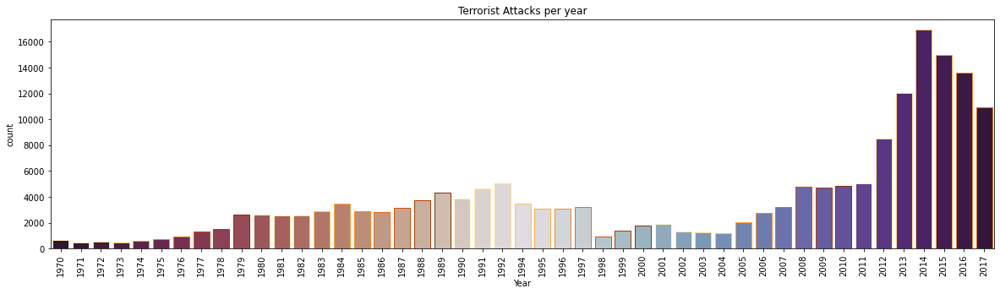

In [10]:
# Terrorist attacks in each year
plt.subplots(figsize=(20,5))
sns.countplot('Year',data=data,palette='twilight_shifted_r',edgecolor=sns.color_palette('YlOrBr',10))
plt.xticks(rotation=90)
plt.title('Terrorist Attacks per year')
plt.show()

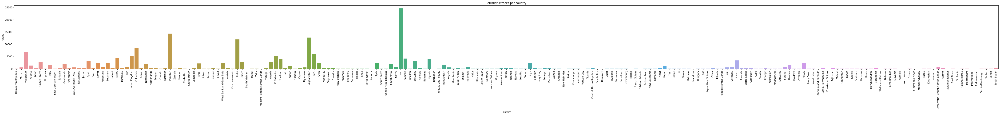

In [11]:
plt.subplots(figsize=(75,5))
sns.countplot('Country',data=data)
plt.xticks(rotation=90)
plt.title('Terrorist Attacks per country')
plt.show()

Iraq is the worst hit country by terrorism with over 24,000 attacks between 1970 to 2017

In [12]:
attack = data.groupby(['Country'],as_index= False).count()

In [13]:
country_fig = px.choropleth(attack,locations ='Country',locationmode = 'country names', hover_name ='Country',color='Year',
                            projection='orthographic',title='Attacks in countries(1970-2017)',
                            labels={'Year':'Attacks'})
country_fig.show()

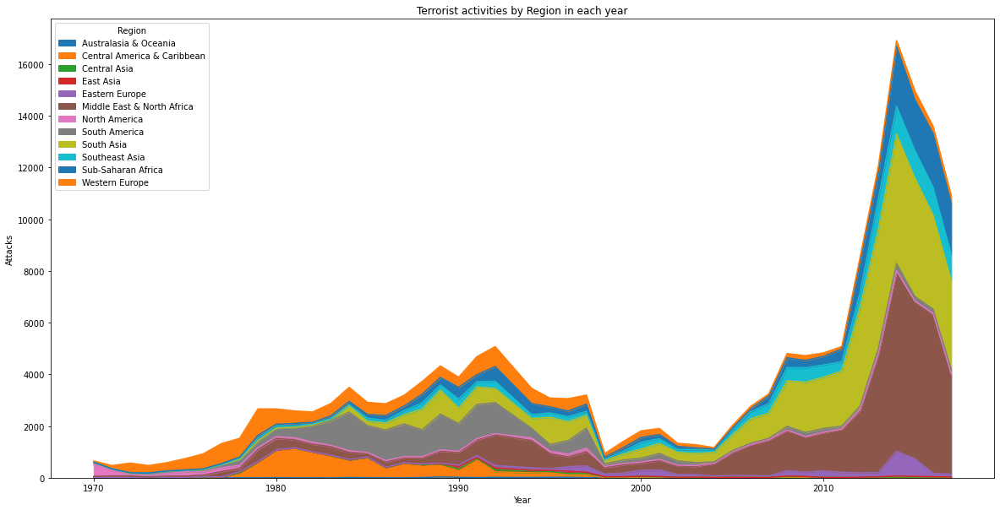

In [14]:
region = pd.crosstab(data.Year,data.Region).plot(kind='area',figsize=(20,10))
plt.title('Terrorist activities by Region in each year')
plt.ylabel('Attacks')
plt.show()

In [15]:
Year = data.Year.value_counts().to_dict()
print('Number of attacks in 1970:',Year[1970] )
print('Number of attacks in 2017:',Year[2017] )
rate = ((Year[2017]-Year[1970])/Year[2017])*100
print('Increase in attacks since 1970:',np.round(rate,2),'%')

Number of attacks in 1970: 651
Number of attacks in 2017: 10900
Increase in attacks since 1970: 94.03 %


In [16]:
max_attacks_in_year = data.Year.value_counts().max()
max_attacks_in_year

16903

# Most active terrorist organisation

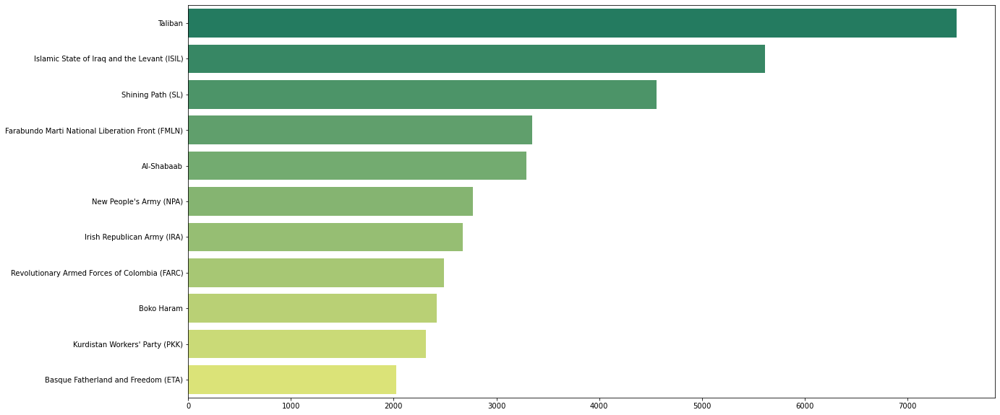

In [17]:
plt.subplots(figsize=(20,10))
sns.barplot(data['Group'].value_counts()[1:12].values, data['Group'].value_counts()[1:12].index,palette='summer')
plt.show()

Taliban is the most active terrorist organisation which carried out more than 7000 attacks

# Methods of carrying out attacks

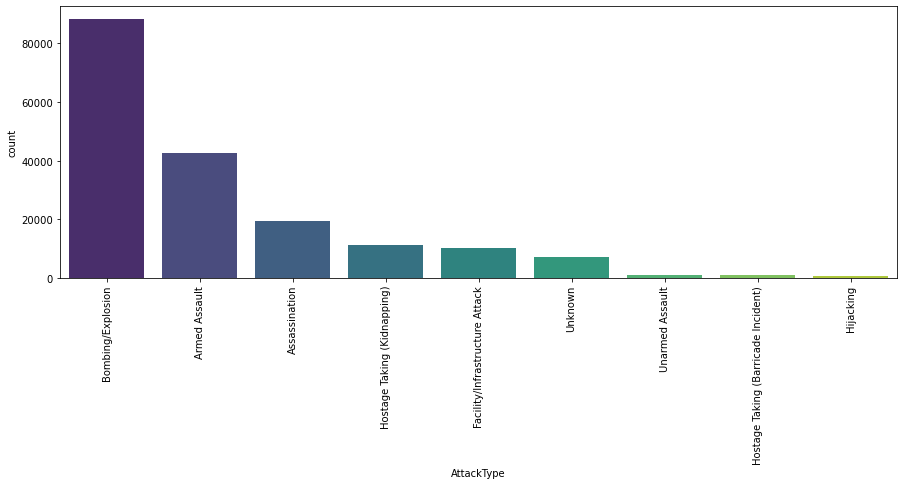

In [18]:
method = data.AttackType.value_counts().index
plt.subplots(figsize=(15,5))
plt.xticks(rotation=90)
sns.countplot(data['AttackType'],order= method, palette= 'viridis')
plt.show()

# Casualities & Deaths

In [19]:
wounded = data.Wounded.sum()
deaths = data.Killed.sum()
print('Total number of casualities:',wounded)
print('Total number of Deaths:',deaths)

Total number of casualities: 523869.0
Total number of Deaths: 411868.0


In [20]:
avg_woud = wounded/len(pd.unique(data['Year'])) 
avg_deaths = deaths/len(pd.unique(data['Year'])) 
print('Average number of casulities:',np.round(avg_woud,1))
print('Average number of deaths:',np.round(avg_deaths,1))

Average number of casulities: 11146.1
Average number of deaths: 8763.1


In [21]:
w=data.groupby('Year').count()

In [22]:
dw = w[['Wounded','Killed']]

Text(0.5, 1.0, 'Number of casualities vs Number of Deaths')

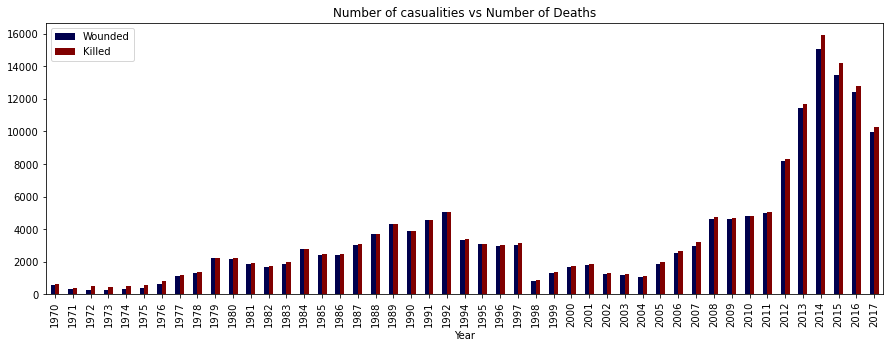

In [23]:
dw.plot(kind='bar',figsize=(15,5),cmap='seismic')
plt.title('Number of casualities vs Number of Deaths')

In [24]:
px.scatter(data,data.Killed,data.Wounded,hover_name='Country',animation_frame='Year',animation_group='Country',color='AttackType',
           range_color=[0,1],labels={'Killed':'Deaths','Wounded':'Casualities'},title='Number of casualities vs Number of deaths in each country for each year')

# Victims

Text(0.5, 1.0, 'Most affected Countries')

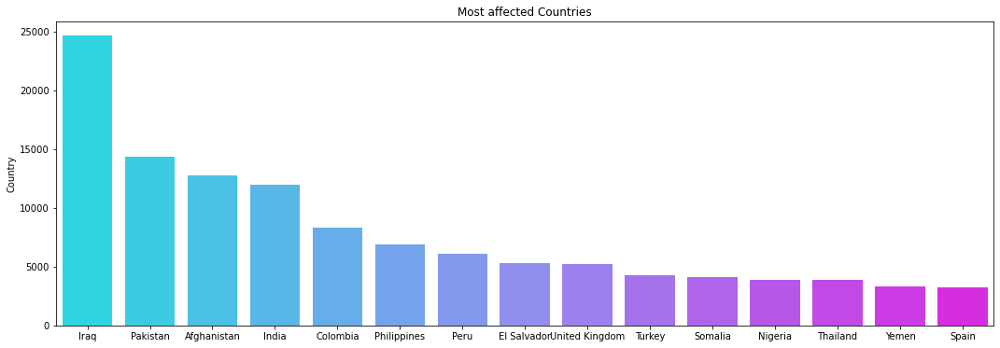

In [25]:
# Top 10 most affected countries
plt.subplots(figsize=(18,6))
sns.barplot(data['Country'].value_counts()[:15].index,data['Country'].value_counts()[:15],palette='cool')
plt.title('Most affected Countries')

c:\users\dell\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:17: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



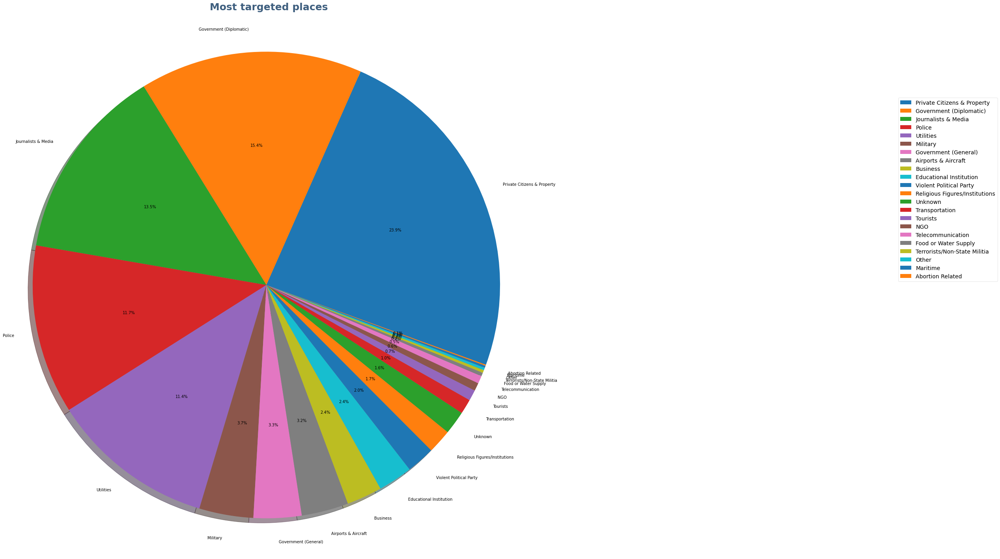

In [26]:
victim = data.TargetType.value_counts().tolist()
labels = data.TargetType.unique().tolist()
sizes = []

for i in victim:
    percent = i*100/len(data['TargetType'])
    sizes.append(percent)

fig, ax = plt.subplots(figsize=(20,20))
patches, texts, autotexts = ax.pie(sizes, labels=labels, autopct='%1.1f%%',startangle = -20, shadow = True)

ax.axis('equal')
plt.title('Most targeted places', fontsize= 25, pad= -70, weight ='bold', 
             color = sns.cubehelix_palette(8, start=.5, rot=-.75)[-3]) #pad change the distance from title to graph
plt.tight_layout()
ax.legend(loc='lower right',framealpha = 0.5,bbox_to_anchor=(1.8,0.5,0.1,1), prop={'size': 14})
fig.show()

CONCLUSION:
1. Iraq is the worst hit country with over 24,000 attacks between 1970 to 2018
2. Taliban is the most active Terrorist organisation.
3. Bombing/explosion is the most common method used
4. Most affected regions are Middle-east Asia & North Africa and South Asia
5. Top four countries victim of terrorism- Iraq, Pakistan, Afghanisthan, India
6. Mostly targeted victims are private citizens or government diplomats
7. Most deaths and casualities happened in 2014
8. There is an increase in the terrorism rate since 1970 by 94%


# THANK YOU!!